# Exploratory Analysis


## Importing Necessary Libraries

We will import the necessary libraries before starting our data exploration and analysis.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import requests
from time import sleep
import json
import random

We notice that the list structure inside genres, keywords and producton_companies was string and not list (due to we download it as csv file, so we do the following code to convert them).

In [2]:
movie_data = pd.read_csv('movie_data.csv')

movie_data['genres'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', '))  if(s2[1:-1]!="")]     for s in movie_data['genres'] ]
movie_data['keywords'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', '))  if(s2[1:-1]!="")]     for s in movie_data['keywords']]
movie_data['production_companies'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', ')) if(s2[1:-1]!="")]     for s in movie_data['production_companies']]
movie_data['age_rating'] = movie_data['age_rating'].astype('category')


movie_data_NC_17_addtional = pd.read_csv('movie_data_NC_17_additional.csv')

movie_data_NC_17_addtional['genres'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', '))  if(s2[1:-1]!="")]     for s in movie_data_NC_17_addtional['genres'] ]
movie_data_NC_17_addtional['keywords'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', '))  if(s2[1:-1]!="")]     for s in movie_data_NC_17_addtional['keywords']]
movie_data_NC_17_addtional['production_companies'] = [  [ s2[1:-1] for s2 in list(s[1:-1].split(', ')) if(s2[1:-1]!="")]     for s in movie_data_NC_17_addtional['production_companies']]
movie_data_NC_17_addtional['age_rating'] = movie_data_NC_17_addtional['age_rating'].astype('category')

print("Shape of the movie_data is ", movie_data.shape )
movie_data.head()


Shape of the movie_data is  (6596, 7)


,id,runtime,genres,keywords,production_companies,age_rating,budget
0,527774,107.0,"[Animation, Adventure, Fantasy, Family, Action]","[kung fu, trip, sword, warrior woman, computer...","[Walt Disney Pictures, Walt Disney Animation S...",PG,0
1,587807,101.0,"[Action, Comedy, Family, Animation, Adventure]","[computer animation, racial stereotype, live a...","[Warner Animation Group, Warner Bros. Pictures...",PG,50000000
2,484718,110.0,[Comedy],"[africa, prince, heir to the throne, sequel, q...","[Paramount, New Republic Pictures, Eddie Murph...",PG-13,60000000
3,458576,104.0,"[Fantasy, Action, Adventure]","[female soldier, another dimension, bow and ar...","[CAPCOM, Constantin Film, Impact Pictures, Ten...",PG-13,60000000
4,464052,151.0,"[Fantasy, Action, Adventure]","[dc comics, superhero, based on comic, 1980s, ...","[DC Entertainment, Warner Bros. Pictures, The ...",PG-13,200000000


Now that we have our data, let us clearly define our objective for this project.

## Objective: Can we predict the age rating of movies?

Taking a look at our data, we are interested in finding out whether it is possible to predict the age-rating of movies using the other variables and data we have.

Age rating is a very interesting variable. Age rating was created to ensure that young people are not exposed to inappropriate content. We are interested to find out whether we can actually predict the age ratings of movies accurately given information about the movie.

However, before we can do that, let us understand more about age rating.

### 1. Understanding Age Rating

When we take a look at our age rating variable and take a closer look, we notice that there is an issue.

Every country has their own age ratings, and TMDB contains movies that are aired in many different countries. That is why our age rating data is a little complicated.

In order to solve this issue, we need to concentrate our focus on US only

First, we get the certifications of different countries from the database and import it.

In [3]:
api_key= "b1541f3ce3b0d884b5d7519402b49e49"
url = f"https://api.themoviedb.org/3/certification/movie/list?api_key={api_key}"
req = requests.get(url)
certification_list = req.json()

Let's take a look at the different countries that are included.

In [4]:
list_of_country_certifications = certification_list['certifications'].keys()
pd.DataFrame(list_of_country_certifications, columns = ['Country Certification'])

,Country Certification
0,CA
1,NL
2,GB
3,AU
4,FR
5,NZ
6,BR
7,PT
8,NO
9,RU


#### US Age Ratings

What are the US age ratings?

In [5]:
US_age_ratings = certification_list['certifications']['US']
pd.DataFrame(US_age_ratings, columns=US_age_ratings[0].keys())

,certification,meaning,order
0,PG-13,Some material may be inappropriate for childre...,3
1,R,Under 17 requires accompanying parent or adult...,4
2,NR,No rating information.,0
3,G,All ages admitted. There is no content that wo...,1
4,PG,Some material may not be suitable for children...,2
5,NC-17,These films contain excessive graphic violence...,5


### Usage of US Age Rating

For our project, we will be trying to predict the US age ratings, so we will only be looking at movies with US age ratings.

In our variable exploration above, we understand that there are 6 categories of Age Ratings in the US: NR, PG, PG-13, R, NC-17 and G. 

Meaning of each age rating are stated in readme.txt

We can see that we does not know any information from NR and that is the reason we did not included it during the data preparation.

### 2. Get the list of genres, keywords, production_companies, age_rating

Taking a look at our data, many of our variables are categorical. We have to find out the different categories that these variables have. We then store them into lists.

### List of Keywords (Independent Variable)

In [6]:
list_of_keywords = list(set([keyword for keyword_list in movie_data['keywords'] for keyword in keyword_list  ]))
pd.DataFrame(list_of_keywords, columns = ['List of Key Words'])

,List of Key Words
0,wrestling
1,hotel suite
2,bron
3,edo period
4,hideout
...,...
11063,koran
11064,rave
11065,possessed
11066,tranksgiving


### List of Genres (Independent Variable)

In [7]:
list_of_genre = list(set([genre for genre_list in movie_data['genres'] for genre in genre_list  ]))
genrelist = pd.DataFrame(list_of_genre, columns = ['List of Genres'])
genrelist

,List of Genres
0,Science Fiction
1,Adventure
2,Romance
3,War
4,Documentary
5,Drama
6,Western
7,Mystery
8,Action
9,Comedy


### List of Production Companies (Independent Variable)

In [8]:
list_of_production_companies = list(set([company for company_list in movie_data['production_companies'] for company in company_list  ]))
pd.DataFrame(list_of_production_companies, columns = ['Production Companies'])

,Production Companies
0,CBC
1,Wallimage
2,Visible Pictures
3,Aurora Entertainment
4,Noelle Entertainment Limited
...,...
6317,Natural Selection
6318,Eddie Murphy Productions
6319,Rockinghorse Films
6320,Reteitalia


# Exploratory Analysis

And we are done with the preliminary data preparation! With that, we will move on to our exploratory analysis.

As mentioned above, we will stick to the US age ratings. In the exploratory analysis, we will be trying to find out the relationships of the different features with our dependent variable (Age Rating).

There are 6 variables (excluding id)

runtime and budget are numeric

genres, keywords and production_companies are categorical

age_rating: the responding variable 


## Uni-variate Exploratory Analysis (Age Rating)

Let's take a look at age rating.

In [9]:
movie_data.describe()

,id,runtime,budget
count,6596.000000,6596.000000,6.596000e+03
mean,139921.783050,103.688599,2.662286e+07
std,192158.352331,21.704300,4.071817e+07
min,5.000000,0.000000,0.000000e+00
25%,9901.500000,92.000000,0.000000e+00
50%,21855.500000,101.000000,1.050000e+07
75%,262501.000000,115.000000,3.500000e+07
max,801609.000000,248.000000,3.800000e+08


### Distribution of Age Rating

Let's take a look at the distribution of age rating.

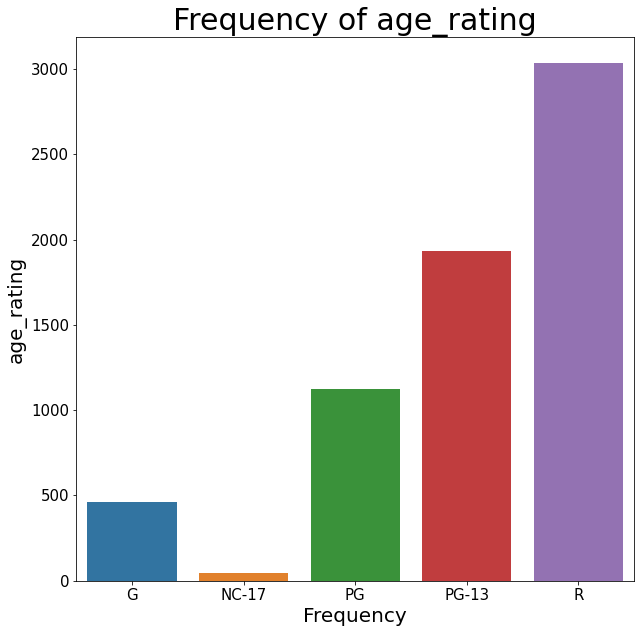

In [10]:
f = plt.figure(figsize=(10,10))
ax = sb.countplot(x='age_rating', data=movie_data)
ax.set_xlabel("Frequency", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("age_rating", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Frequency of age_rating", size = 30)
plt.show()


plt.show()

### Issue: Class Imbalance

Here, we notice that there is a lack of data for G and NC-17. On the other hand age ratings such as R and PG-13 has alot of data. This means that there is a class imbalance because both the counts of G and NC-17 are very low as compared to the other ratings. 

This may cause problems as when our model predicts the age ratings, it will most probably predict the other three ratings and may not predict the age rating to be G or NC-17. Our models may have a bias as a result of the class imbalance.


### Solution?

When we faced the issue of class imbalance initially, we did not know whether it would affect the model prediction ability. Therefore, we decided to fit the model with the original data first to check if our model is affected by the class imbalance.

After fitting the model, we realised that this is an issue affecting our model due to the above mentioned reasons. However, we found that this issue only significantly affects the prediction of the NC-17 rating and not the G rating. Thus, we will need to rectify this issue. (see model training)

We tried to rectify this issue by adding more data for NC-17 movies.This is done by getting more NC-17 movie data from the movie database. We have imported the additional data above.

In [11]:
print( "Length of movie data" , len(movie_data) )
print( "Length of movie data with addtional NC_17" , len(movie_data_NC_17_addtional) )

print()
print("Number of data improved ",  len(movie_data_NC_17_addtional) - len(movie_data) )

Length of movie data 6596
Length of movie data with addtional NC_17 6959

Number of data improved  363


Let's take a look at the new data that we have added the additional NC-17 data to.

In [12]:
movie_data_NC_17_addtional.describe()

,id,runtime,budget
count,6959.000000,6956.000000,6.959000e+03
mean,147868.356948,102.674526,2.527399e+07
std,198904.092285,23.280835,4.007127e+07
min,5.000000,0.000000,0.000000e+00
25%,10029.500000,91.000000,0.000000e+00
50%,25793.000000,101.000000,1.000000e+07
75%,277616.000000,114.000000,3.300000e+07
max,820282.000000,293.000000,3.800000e+08


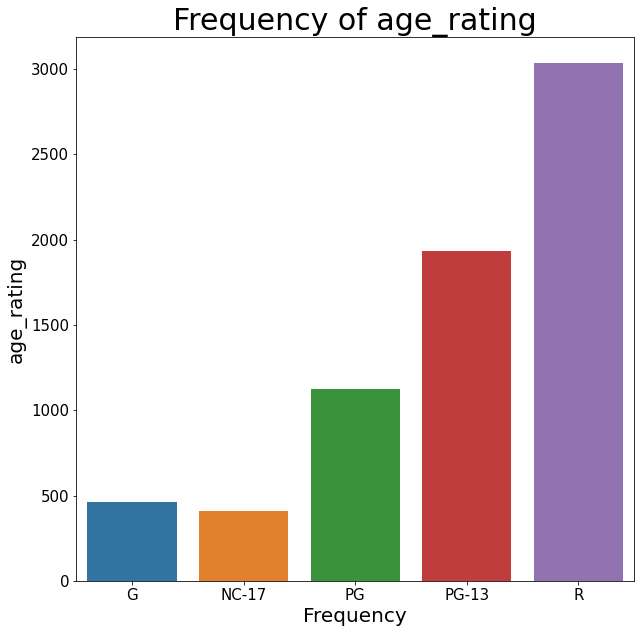

In [13]:
f = plt.figure(figsize=(10,10))
sb.countplot(x='age_rating', data=movie_data_NC_17_addtional)
ax = sb.countplot(x='age_rating', data=movie_data)
ax.set_xlabel("Frequency", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("age_rating", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Frequency of age_rating", size = 30)
plt.show()
plt.show()

### Observation:
we notice that number of data of NC-17 improve by 363 (as all the data we extend are NC-17). The data are more balanced than the previous, we expect the better result in model training.


By using this data, we have retrain the model (see model training) and it improved. 

The exploratory analysis onward will be using the more balanced data

## Exploratory Analysis (Numeric Features)

Let's take a look at the three numeric features: runtime and budget 

In [14]:
movienumdata = pd.DataFrame(movie_data_NC_17_addtional[['runtime','budget']])
movienumdata

,runtime,budget
0,107.0,0
1,101.0,50000000
2,110.0,60000000
3,104.0,60000000
4,151.0,200000000
...,...,...
6954,90.0,0
6955,82.0,0
6956,112.0,0
6957,85.0,0


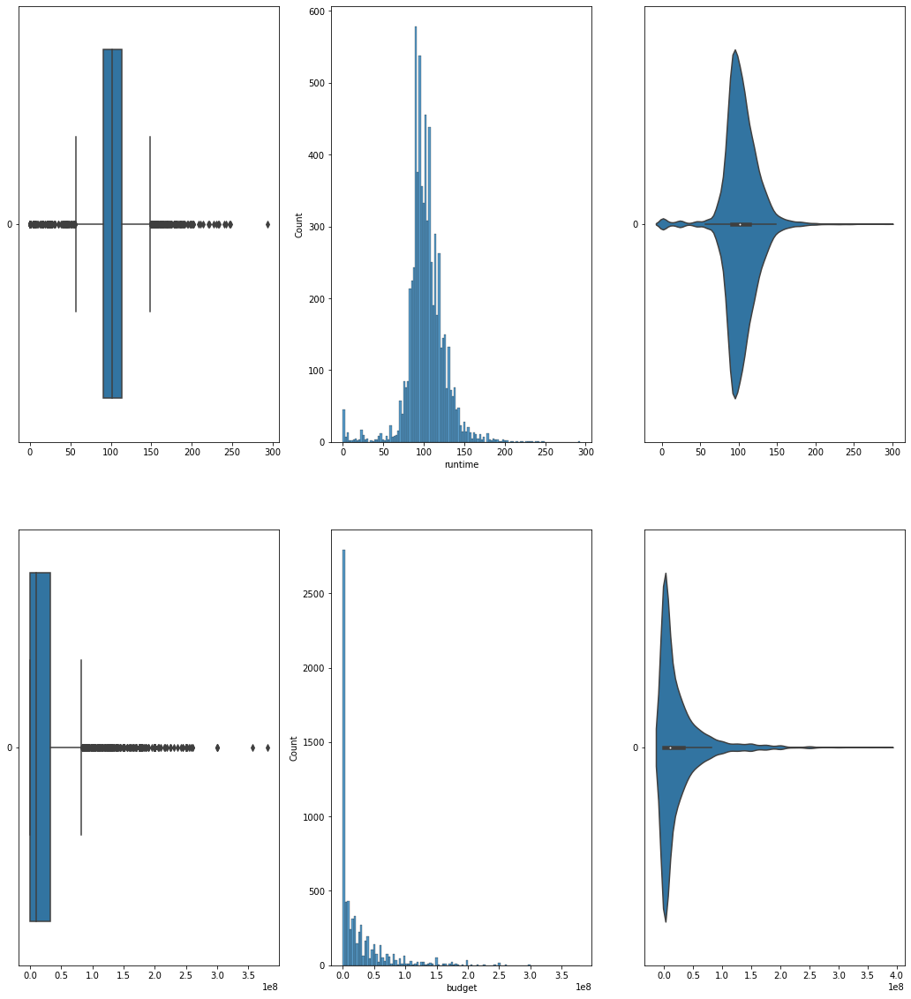

In [15]:
# Draw the distributions of all variables
f, axes = plt.subplots(2, 3, figsize=(18, 20))

count = 0
    
for var in movienumdata:
    sb.boxplot(data = movienumdata[var], orient = "h", ax = axes[count,0])
    
    sb.histplot(data = movienumdata[var], ax = axes[count,1])
    sb.violinplot(data = movienumdata[var], orient = "h", ax = axes[count,2])
    
    count += 1
plt.show()

In [16]:
# Calculate the quartiles
Q1 = movienumdata.quantile(0.25)
Q3 = movienumdata.quantile(0.75)

# Rule to identify outliers
rule = ((movienumdata < (Q1 - 1.5 * (Q3 - Q1))) | (movienumdata > (Q3 + 1.5 * (Q3 - Q1))))

# Count the number of outliers
rule.sum()

runtime    347
budget     535
dtype: int64

We can see that runtime and budget have relatively low numbers of outliers

## Bi-Variate Exploratory Analysis - Data Visualization (Numeric Features)

We plot out the distributions of age ratings against the numeric variables.

### 1. Age rating against runtime

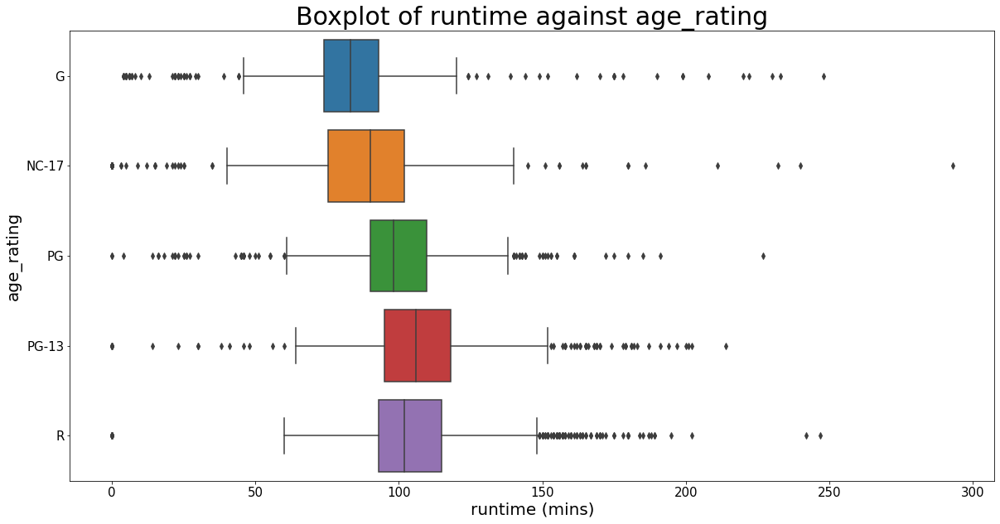

In [17]:
## Checking Relationship between runtime and age_rating
f = plt.figure(figsize=(20,10))

ax = sb.boxplot(x='runtime', y='age_rating' , data = movie_data_NC_17_addtional, orient='h')
ax.set_xlabel("runtime (mins)", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("age_rating", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Boxplot of runtime against age_rating", size = 30)
plt.show()



The spread of the runtime data is similar for all the age ratings, but this is expected because many movies have around the same runtime. However, there are still slight distribution among each rating, therefore it may not have correlation

### 2. Age rating against Budget 

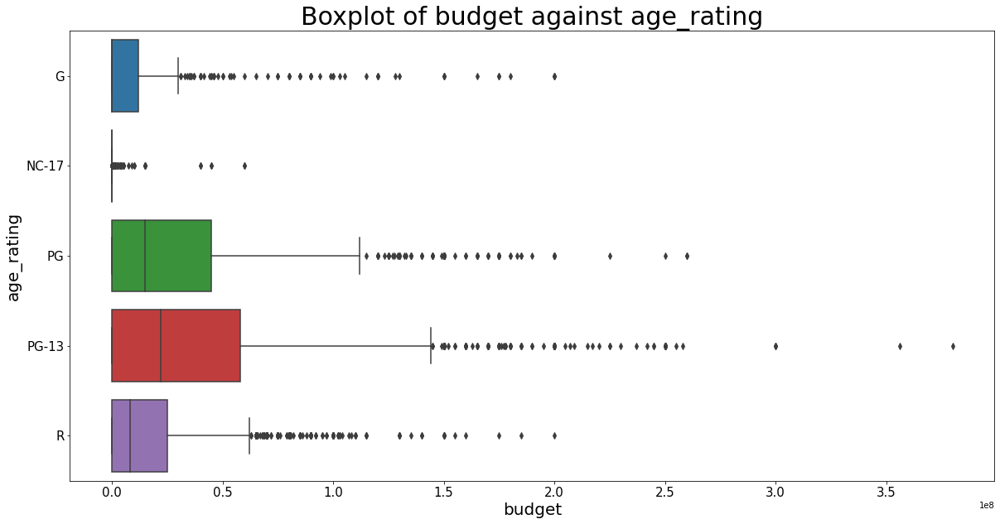

In [18]:
# checking between budget and age_rating

f = plt.figure(figsize=(20,10))
ax =sb.boxplot(x='budget', y='age_rating' , data = movie_data_NC_17_addtional, orient='h')
ax.set_xlabel("budget", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("age_rating", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Boxplot of budget against age_rating", size = 30)
plt.show()

In [19]:
(movie_data_NC_17_addtional['budget']==0).value_counts()

False    4604
True     2355
Name: budget, dtype: int64

In [20]:
movie_data_NC_17_addtional[movie_data_NC_17_addtional['budget']==0]['age_rating'].value_counts()

R        887
PG-13    482
PG       377
NC-17    331
G        278
Name: age_rating, dtype: int64

We notice that there are a lot of rows with zero budget (2355 out of 6959). However, it seems to be quite important, so we did not exclude it during the training, however, we exclude it for this exploratory analysis so that we can see the distribution as shown below

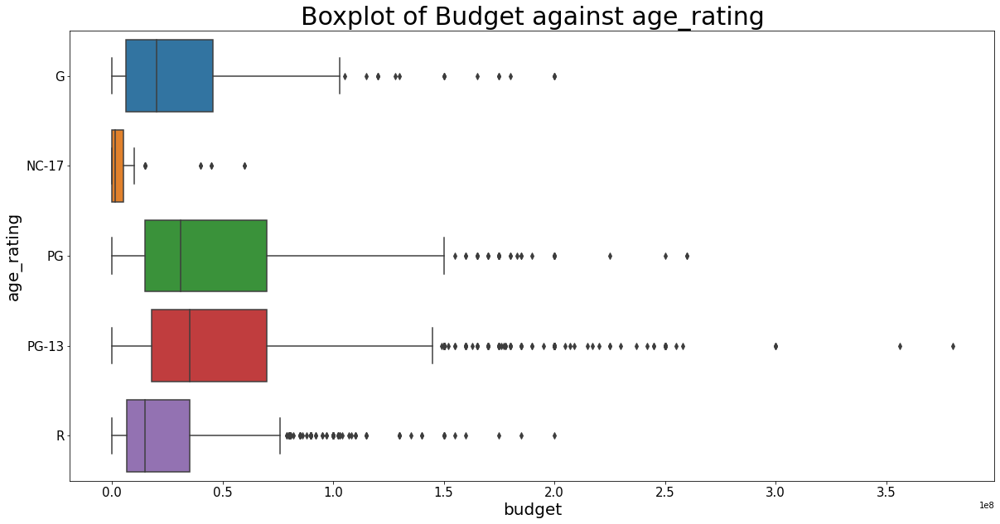

In [21]:
# checking between budget and age_rating

f = plt.figure(figsize=(20,10))
ax = sb.boxplot(x='budget', y='age_rating' , data = movie_data_NC_17_addtional[ movie_data_NC_17_addtional['budget']!=0 ], orient='h')
ax.set_xlabel("budget", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("age_rating", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Boxplot of Budget against age_rating", size = 30)
plt.show()
plt.show()

We can see that budget varies quite a fair bit against age rating, so it may be a good variable to use to predict age rating.

## Exploratory Analysis - Data Visualization (Categorical Features)

## 1. Genres

This is a little tricky - each movie may have more than one genre, and that is why genres is encoded as a list in the dataframe column. Thus, we need to find a way around this.

Thus, in order to deal with lists in our data, we took inspiration from this article: https://towardsdatascience.com/dealing-with-list-values-in-pandas-dataframes-a177e534f173

### Step 1: Get age rating, and convert it to one hot encoded form

In [22]:
agerating = pd.DataFrame(movie_data_NC_17_addtional['age_rating'])
agerating

,age_rating
0,PG
1,PG
2,PG-13
3,PG-13
4,PG-13
...,...
6954,NC-17
6955,NC-17
6956,NC-17
6957,NC-17


In [23]:
agerating_1HE = pd.get_dummies(agerating)
agerating_1HE

,age_rating_G,age_rating_NC-17,age_rating_PG,age_rating_PG-13,age_rating_R
0,0,0,1,0,0
1,0,0,1,0,0
2,0,0,0,1,0
3,0,0,0,1,0
4,0,0,0,1,0
...,...,...,...,...,...
6954,0,1,0,0,0
6955,0,1,0,0,0
6956,0,1,0,0,0
6957,0,1,0,0,0


### Step 2: Get genres and put it into a dataframe

In [24]:
genres = pd.DataFrame(movie_data_NC_17_addtional['genres'])
genres

,genres
0,"[Animation, Adventure, Fantasy, Family, Action]"
1,"[Action, Comedy, Family, Animation, Adventure]"
2,[Comedy]
3,"[Fantasy, Action, Adventure]"
4,"[Fantasy, Action, Adventure]"
...,...
6954,"[Drama, Horror]"
6955,[Documentary]
6956,[Drama]
6957,[Drama]


### Step 3: Check the data types of all rows in genres

We need to ensure they are lists and not strings.

In [25]:
for i, l in enumerate(genres["genres"]):
    assert type(l) == list

### Step 4: Convert the lists into a 1D series

Here, we get the different counts of each genre.

In [26]:
genres_value_count = pd.Series([x for _list in genres["genres"] for x in _list]).value_counts()
genres_value_count

Drama              2669
Comedy             2310
Thriller           1979
Action             1944
Adventure          1333
Family             1036
Horror             1033
Romance            1022
Crime              1018
Fantasy             868
Science Fiction     866
Animation           799
Mystery             579
History             272
Music               233
War                 199
TV Movie            121
Documentary         110
Western              81
dtype: int64

### Step 5: Visualise the genre data

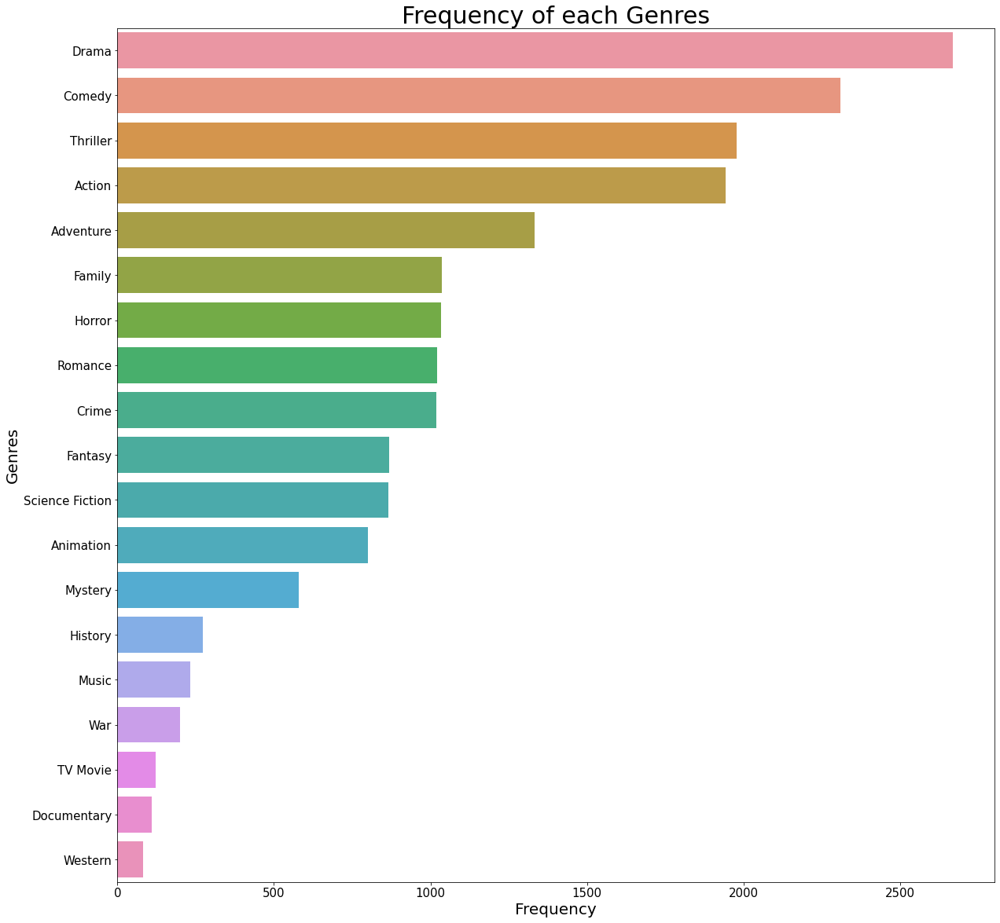

In [27]:
fig, ax = plt.subplots(figsize = (20,20))

sb.barplot(y=genres_value_count.index,
        x=genres_value_count.values, orient='h')
ax.set_xlabel("Frequency", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("Genres", size = 20)
plt.yticks(fontsize=15)
ax.set_title("Frequency of each Genres", size = 30)
plt.show()

We can see from the plot above that the genre with the highest number of movies is drama, followed by comedy. Western has the lowest number out of all the genres.

### Step 6: Convert the genre data into a one-hot encoded form

In [28]:
def boolean_df(item_lists, unique_items):
    
    # Create empty dict
    bool_dict = {}
    
    # Loop through all the tags
    for i, item in enumerate(unique_items):
        
        # Apply boolean mask
        bool_dict[item] = item_lists.apply(lambda x: item in x)
            
    # Return the results as a dataframe
    return pd.DataFrame(bool_dict)

In [29]:
genres_bool = boolean_df(genres["genres"], genres_value_count.index)
genres_bool

,Drama,Comedy,Thriller,Action,Adventure,Family,Horror,Romance,Crime,Fantasy,Science Fiction,Animation,Mystery,History,Music,War,TV Movie,Documentary,Western
0,False,False,False,True,True,True,False,False,False,True,False,True,False,False,False,False,False,False,False
1,False,True,False,True,True,True,False,False,False,False,False,True,False,False,False,False,False,False,False
2,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,True,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False
4,False,False,False,True,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False
6955,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
6956,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
6957,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [30]:
genres_int = genres_bool.astype(int)
genres_int

,Drama,Comedy,Thriller,Action,Adventure,Family,Horror,Romance,Crime,Fantasy,Science Fiction,Animation,Mystery,History,Music,War,TV Movie,Documentary,Western
0,0,0,0,1,1,1,0,0,0,1,0,1,0,0,0,0,0,0,0
1,0,1,0,1,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
6955,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
6956,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6957,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Step 7: Combine age rating data with the genres data

In [31]:
genres_freq_mat = np.dot(agerating_1HE.T, genres_int)
genres_freq_mat

array([[  71,  200,    2,   33,  167,  388,    5,   56,    5,  133,   32,
         311,   17,    9,   42,    4,   47,   11,    4],
       [ 131,   75,   87,   66,   14,    0,   77,   46,   40,   28,   31,
          18,   18,    3,   14,    2,    7,   35,    3],
       [ 291,  597,   76,  250,  481,  600,   25,  140,   52,  294,  153,
         325,   40,   38,   51,   15,   36,   18,    7],
       [ 833,  699,  471,  694,  454,   48,  178,  445,  185,  262,  346,
         112,  143,  103,   64,   52,   17,   20,   23],
       [1343,  739, 1343,  901,  217,    0,  748,  335,  736,  151,  304,
          33,  361,  119,   62,  126,   14,   26,   44]])

### Step 8: Get the distribution of age rating against genres

In [32]:
genres_age_freq = pd.DataFrame(genres_freq_mat, columns = genres_value_count.index, index = agerating_1HE.keys())
genres_age_freq

,Drama,Comedy,Thriller,Action,Adventure,Family,Horror,Romance,Crime,Fantasy,Science Fiction,Animation,Mystery,History,Music,War,TV Movie,Documentary,Western
age_rating_G,71,200,2,33,167,388,5,56,5,133,32,311,17,9,42,4,47,11,4
age_rating_NC-17,131,75,87,66,14,0,77,46,40,28,31,18,18,3,14,2,7,35,3
age_rating_PG,291,597,76,250,481,600,25,140,52,294,153,325,40,38,51,15,36,18,7
age_rating_PG-13,833,699,471,694,454,48,178,445,185,262,346,112,143,103,64,52,17,20,23
age_rating_R,1343,739,1343,901,217,0,748,335,736,151,304,33,361,119,62,126,14,26,44


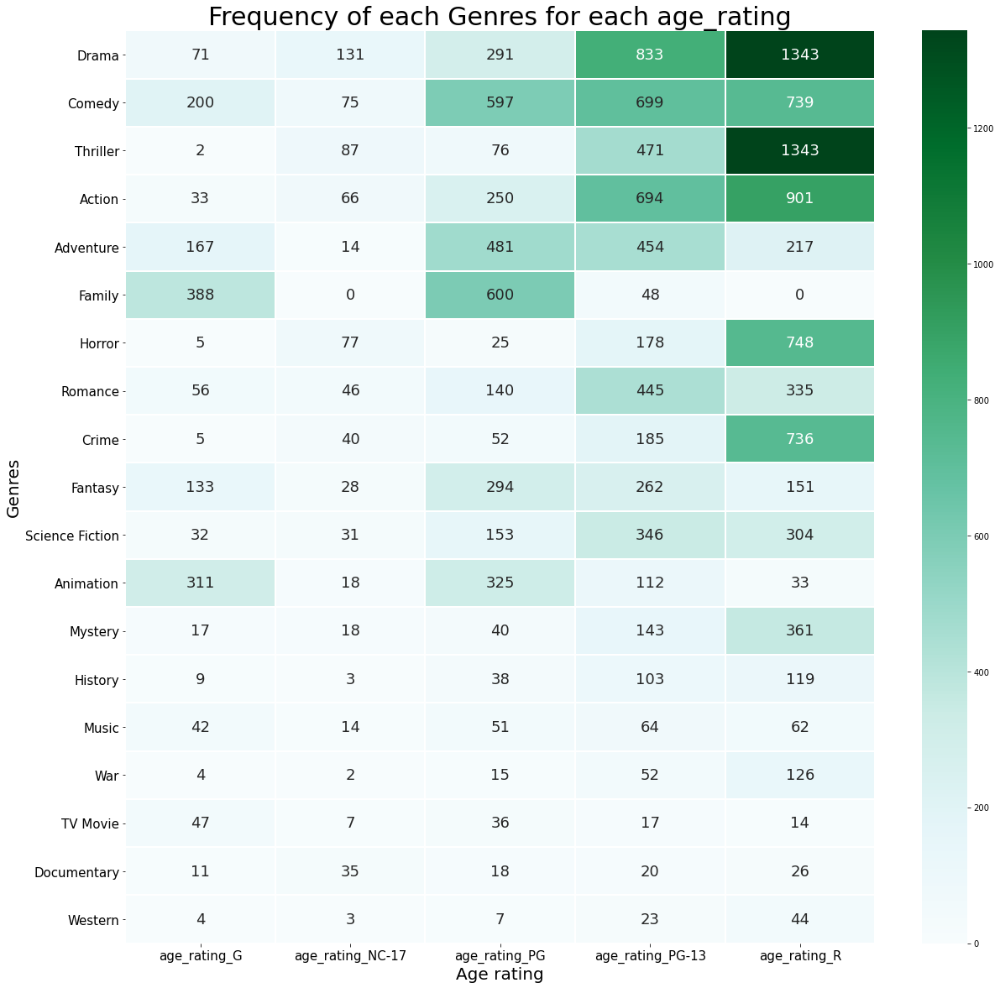

In [33]:
f = plt.figure(figsize=(20, 20))
ax = sb.heatmap(genres_age_freq.transpose(), linewidths = 1,
           annot = True, fmt = ".0f", annot_kws = {"size": 18}, cmap = "BuGn")
ax.set_title ("Frequency of each Genres for each age_rating", size = 30)
ax.set_xlabel("Age rating", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("Genres", size = 20)
plt.yticks(fontsize=15)
plt.show()

From the heatmap, we can tell that there are a lot of movies that 

## 2. Keywords

### Step 1: Extract keywords to a dataframe

In [34]:
keywords = pd.DataFrame(movie_data_NC_17_addtional['keywords'])
keywords

,keywords
0,"[kung fu, trip, sword, warrior woman, computer..."
1,"[computer animation, racial stereotype, live a..."
2,"[africa, prince, heir to the throne, sequel, q..."
3,"[female soldier, another dimension, bow and ar..."
4,"[dc comics, superhero, based on comic, 1980s, ..."
...,...
6954,"[prison warden, sexploitation]"
6955,"[porn star, behind the scenes, porn industry, ..."
6956,"[age difference, erotic movie]"
6957,[erotic movie]


### Step 2: Check if all the keywords are stored in lists

In [35]:
for i, l in enumerate(keywords["keywords"]):
    assert type(l) == list

### Step 3: Convert dataframe to a 1-dimensional series, and print out the value count

In [36]:
keywords_value_counts = pd.Series([x for _list in keywords["keywords"] for x in _list]).value_counts()
keywords_value_counts

based on novel or book    572
murder                    367
duringcreditsstinger      337
violence                  323
sequel                    320
                         ... 
unknown father              1
video wall                  1
dollmaker                   1
wonder woman                1
message                     1
Length: 11180, dtype: int64

### Step 4: Plot wordcloud of keywords

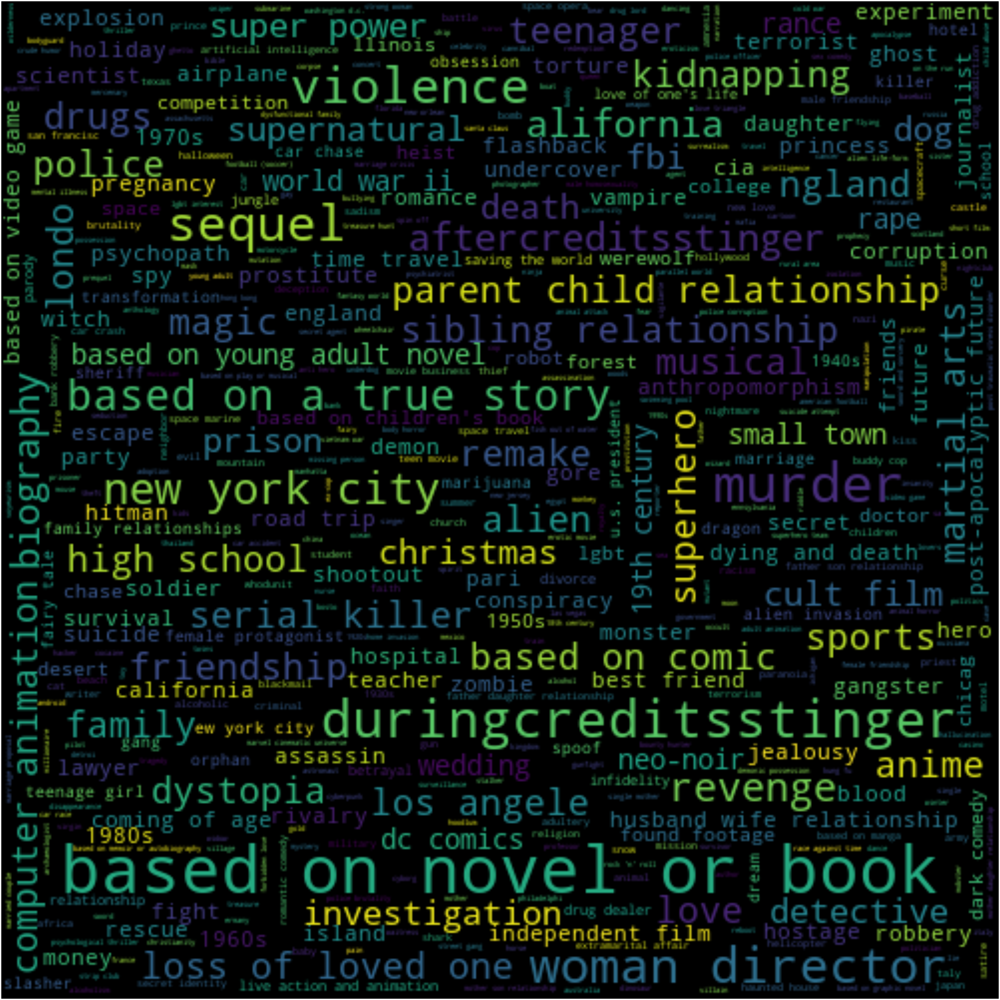

In [37]:
from wordcloud import WordCloud
from collections import Counter

word_could_dict=Counter(list(pd.Series([x for _list in keywords["keywords"] for x in _list])))
wordcloud = WordCloud(width = 500, height = 500, max_words=None).generate_from_frequencies(word_could_dict) 
#wordcloud = WordCloud(width=1000, height= 1000, max_words=None, ).generate(' '.join(list(to_1D(keywords["keywords"]))))
f = plt.figure(figsize=(100,100))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Step 5: Put the counts into a dataframe

In [38]:
keywords_count = pd.DataFrame(keywords_value_counts,columns ={'counts'})
keywords_count

,counts
based on novel or book,572
murder,367
duringcreditsstinger,337
violence,323
sequel,320
...,...
unknown father,1
video wall,1
dollmaker,1
wonder woman,1


We have 11180 rows of keywords. This is a large number, and it will be impossible to visualise all keywords against age rating, thus we will look at all keywords with counts of more than 100 in order for visualisation.

In [39]:
keywords_100 = keywords_count[keywords_count['counts']>100]
keywords_100

,counts
based on novel or book,572
murder,367
duringcreditsstinger,337
violence,323
sequel,320
woman director,314
new york city,244
based on a true story,229
revenge,211
biography,199


In [40]:
keywords_100.shape

(45, 1)

### Step 6: Convert the keywords data to one-hot encoded form

In [41]:
keywords_bool = boolean_df(keywords["keywords"], keywords_value_counts.index)
keywords_bool

,based on novel or book,murder,duringcreditsstinger,violence,sequel,woman director,new york city,based on a true story,revenge,biography,...,television broadcast,multiverse,commander,mislaid trust,siberia,unknown father,video wall,dollmaker,wonder woman,message
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6955,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6956,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6957,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [42]:
keywords_int = keywords_bool.astype(int)
keywords_int

,based on novel or book,murder,duringcreditsstinger,violence,sequel,woman director,new york city,based on a true story,revenge,biography,...,television broadcast,multiverse,commander,mislaid trust,siberia,unknown father,video wall,dollmaker,wonder woman,message
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6955,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6956,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6957,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Step 7: Combine agerating and keywords data

In [43]:
keywords_freq_mat = np.dot(agerating_1HE.T, keywords_int)
keywords_freq_mat

array([[ 26,   2,  20, ...,   0,   0,   0],
       [ 10,  11,   0, ...,   0,   0,   0],
       [110,  10,  88, ...,   0,   0,   0],
       [194,  54, 116, ...,   1,   1,   1],
       [232, 290, 113, ...,   0,   0,   0]])

In [44]:
keywords_age_freq = pd.DataFrame(keywords_freq_mat, columns = keywords_value_counts.index, index = agerating_1HE.keys())
keywords_age_freq

,based on novel or book,murder,duringcreditsstinger,violence,sequel,woman director,new york city,based on a true story,revenge,biography,...,television broadcast,multiverse,commander,mislaid trust,siberia,unknown father,video wall,dollmaker,wonder woman,message
age_rating_G,26,2,20,0,31,19,7,3,3,3,...,0,0,0,0,0,0,0,0,0,0
age_rating_NC-17,10,11,0,15,2,9,12,1,9,2,...,0,0,0,0,0,0,0,0,0,0
age_rating_PG,110,10,88,5,62,56,31,38,11,28,...,0,0,0,0,0,0,0,0,0,0
age_rating_PG-13,194,54,116,50,85,114,76,73,38,76,...,1,1,0,1,0,0,0,1,1,1
age_rating_R,232,290,113,253,140,116,118,114,150,90,...,0,0,1,0,1,1,1,0,0,0


### Step 8: Take the first 45 columns, which are the keywords with counts > 100

In [45]:
keywords_age_100 = keywords_age_freq.iloc[:, 0:45]
keywords_age_100

,based on novel or book,murder,duringcreditsstinger,violence,sequel,woman director,new york city,based on a true story,revenge,biography,...,londo,drugs,kidnapping,super power,dog,fbi,christmas,investigation,cult film,prison
age_rating_G,26,2,20,0,31,19,7,3,3,3,...,8,0,2,5,35,0,24,0,4,1
age_rating_NC-17,10,11,0,15,2,9,12,1,9,2,...,2,7,8,4,0,0,1,0,5,2
age_rating_PG,110,10,88,5,62,56,31,38,11,28,...,26,2,7,30,37,3,40,8,14,6
age_rating_PG-13,194,54,116,50,85,114,76,73,38,76,...,35,10,25,60,17,29,24,23,3,20
age_rating_R,232,290,113,253,140,116,118,114,150,90,...,53,102,79,15,20,76,18,76,76,72


### Step 9: Plot the heatmap of keywords with counts > 100 against age rating

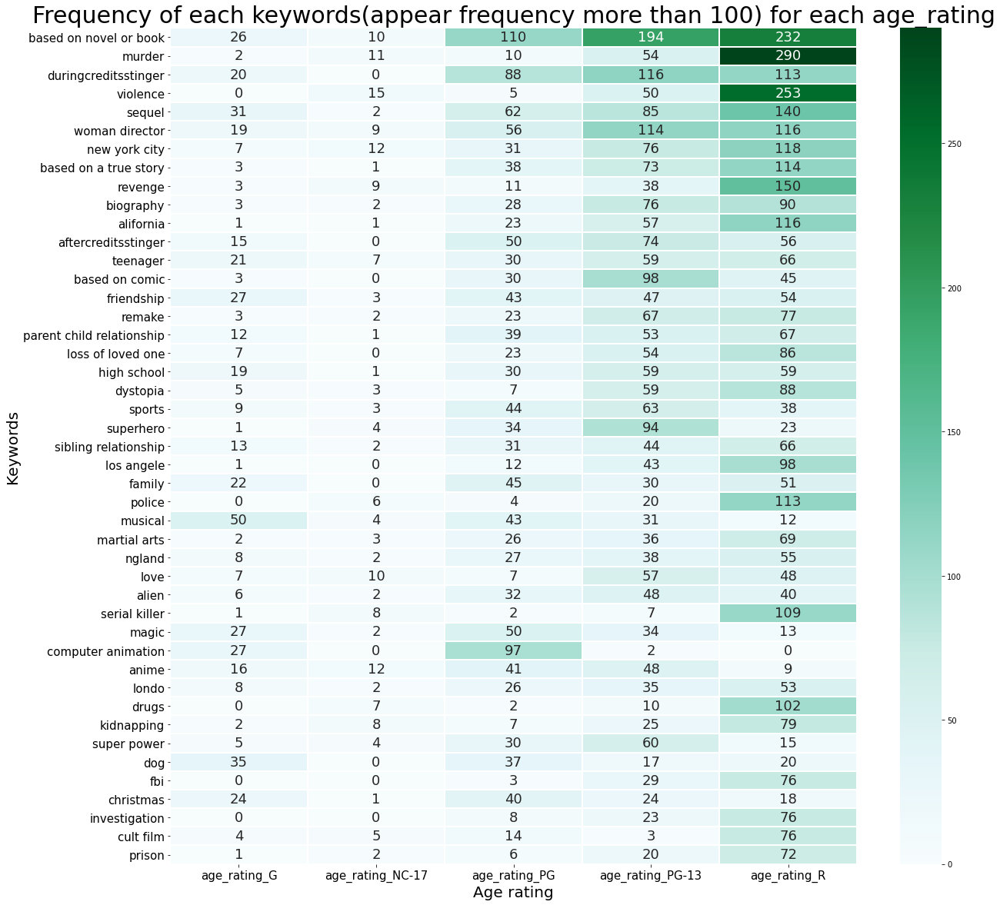

In [46]:
f = plt.figure(figsize=(20, 20))
ax = sb.heatmap(keywords_age_100.transpose(), linewidths = 1,
           annot = True, fmt = ".0f", annot_kws = {"size": 18}, cmap = "BuGn")

ax.set_title ("Frequency of each keywords(appear frequency more than 100) for each age_rating", size = 30)
ax.set_xlabel("Age rating", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("Keywords", size = 20)
plt.yticks(fontsize=15)
plt.show()

We see that actually the keywords do have some correlation with age_rating, for example movie with keywords musical have more data (50), dog(35) for age_rating_G. While keywords such as prison, cult film more data in age_rating_R 

## 3. Production companies

### Step 1: Put the production companies data into a dataframe

In [47]:
prodcomps = pd.DataFrame(movie_data_NC_17_addtional['production_companies'])
prodcomps

,production_companies
0,"[Walt Disney Pictures, Walt Disney Animation S..."
1,"[Warner Animation Group, Warner Bros. Pictures..."
2,"[Paramount, New Republic Pictures, Eddie Murph..."
3,"[CAPCOM, Constantin Film, Impact Pictures, Ten..."
4,"[DC Entertainment, Warner Bros. Pictures, The ..."
...,...
6954,"[Cinépix, Elite Film]"
6955,"[Berns Brothers Productions, Cafe Sisters Prod..."
6956,"[Shin Cine Communications, Korea Pictures]"
6957,"[Ejve-Film, Filmmakarna, Unicorn Enterprises]"


### Step 2: Check if every row is stored in a list

In [48]:
for i, l in enumerate(prodcomps["production_companies"]):
    assert type(l) == list

### Step 3: Convert dataframe to a 1-dimensional series, and print out the value count

In [49]:
pc_value_counts = pd.Series([x for _list in prodcomps["production_companies"] for x in _list]).value_counts()
pc_value_counts

Warner Bros. Pictures        470
Universal Pictures           462
Paramount                    353
Columbia Pictures            350
20th Century Fox             313
                            ... 
Uhlandfilm                     1
Spooky Tooth Productions       1
Motion Picture Associates      1
ArtPhyl                        1
Seven Arcs                     1
Length: 6623, dtype: int64

### Step 4: Plot the wordcloud

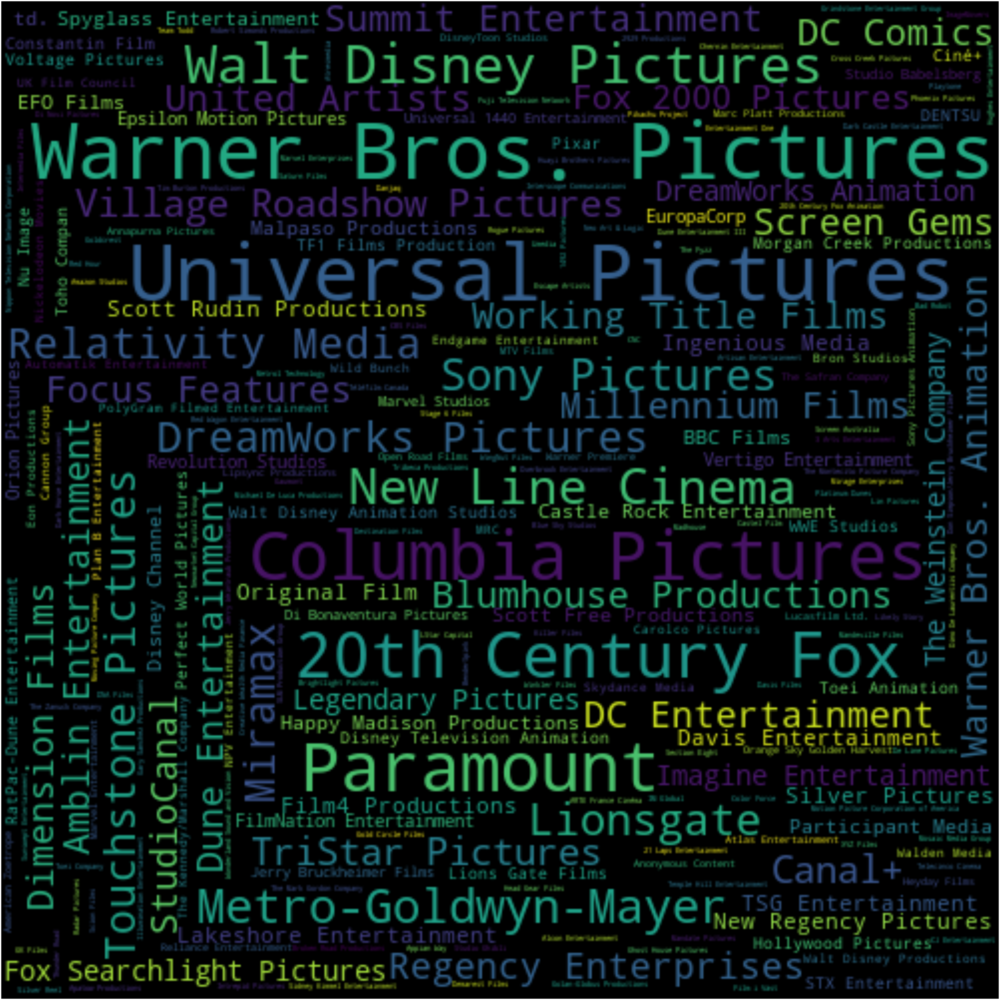

In [50]:
word_could_dict=Counter(pd.Series([x for _list in prodcomps["production_companies"] for x in _list]))
wordcloud = WordCloud(width = 500, height = 500, max_words=None).generate_from_frequencies(word_could_dict) 
f = plt.figure(figsize=(100,100))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Step 5: Put the counts into a dataframe

In [51]:
prodcomps_count = pd.DataFrame(pc_value_counts,columns ={'counts'})
prodcomps_count

,counts
Warner Bros. Pictures,470
Universal Pictures,462
Paramount,353
Columbia Pictures,350
20th Century Fox,313
...,...
Uhlandfilm,1
Spooky Tooth Productions,1
Motion Picture Associates,1
ArtPhyl,1


We have 6623 rows of production companies. This is a large number, and it will be impossible to visualise all production companies against age rating, thus we will look at all production companies with counts of more than 100 in order for visualisation.

In [52]:
prodcomps_count_100 = prodcomps_count[prodcomps_count['counts']>100]
prodcomps_count_100

,counts
Warner Bros. Pictures,470
Universal Pictures,462
Paramount,353
Columbia Pictures,350
20th Century Fox,313
Walt Disney Pictures,213
New Line Cinema,181
Metro-Goldwyn-Mayer,169
Lionsgate,136
Sony Pictures,134


In [53]:
prodcomps_count_100.shape

(14, 1)

### Step 6: Convert the production companies data to one-hot encoded form

In [54]:
prodcomps_bool = boolean_df(prodcomps["production_companies"],pc_value_counts.index)
prodcomps_bool

,Warner Bros. Pictures,Universal Pictures,Paramount,Columbia Pictures,20th Century Fox,Walt Disney Pictures,New Line Cinema,Metro-Goldwyn-Mayer,Lionsgate,Sony Pictures,...,Apple Corps,Black Hat Productions,Smoking Gun Productions,Eastern Productions,Boomdozer,Uhlandfilm,Spooky Tooth Productions,Motion Picture Associates,ArtPhyl,Seven Arcs
0,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False
4,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6955,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6956,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6957,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [55]:
prodcomps_int = prodcomps_bool.astype(int)
prodcomps_int

,Warner Bros. Pictures,Universal Pictures,Paramount,Columbia Pictures,20th Century Fox,Walt Disney Pictures,New Line Cinema,Metro-Goldwyn-Mayer,Lionsgate,Sony Pictures,...,Apple Corps,Black Hat Productions,Smoking Gun Productions,Eastern Productions,Boomdozer,Uhlandfilm,Spooky Tooth Productions,Motion Picture Associates,ArtPhyl,Seven Arcs
0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6954,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6955,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6956,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6957,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Step 7: Combine the age rating data and production companies data

In [56]:
prodcomps_freq_mat = np.dot(agerating_1HE.T, prodcomps_int)
prodcomps_freq_mat

array([[ 10,  18,   7, ...,   1,   0,   0],
       [  1,   1,   1, ...,   0,   0,   0],
       [ 96,  80,  68, ...,   0,   0,   0],
       [169, 171, 144, ...,   0,   1,   0],
       [194, 192, 133, ...,   0,   0,   1]])

In [57]:
prodcomps_age_freq = pd.DataFrame(prodcomps_freq_mat, columns = pc_value_counts.index, index = agerating_1HE.keys())
prodcomps_age_freq

,Warner Bros. Pictures,Universal Pictures,Paramount,Columbia Pictures,20th Century Fox,Walt Disney Pictures,New Line Cinema,Metro-Goldwyn-Mayer,Lionsgate,Sony Pictures,...,Apple Corps,Black Hat Productions,Smoking Gun Productions,Eastern Productions,Boomdozer,Uhlandfilm,Spooky Tooth Productions,Motion Picture Associates,ArtPhyl,Seven Arcs
age_rating_G,10,18,7,4,17,85,1,5,1,2,...,1,0,0,0,0,0,0,1,0,0
age_rating_NC-17,1,1,1,0,1,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,0
age_rating_PG,96,80,68,70,73,113,15,38,4,38,...,0,0,0,0,0,0,0,0,0,0
age_rating_PG-13,169,171,144,145,114,15,64,70,44,51,...,0,0,0,0,0,1,0,0,1,0
age_rating_R,194,192,133,131,108,0,100,56,87,43,...,0,0,1,1,1,0,1,0,0,1


### Step 8: Take the first 14 columns, which are the production companies with counts > 100

In [58]:
prodcomps_age_14 = prodcomps_age_freq.iloc[:, 0:14]
prodcomps_age_14

,Warner Bros. Pictures,Universal Pictures,Paramount,Columbia Pictures,20th Century Fox,Walt Disney Pictures,New Line Cinema,Metro-Goldwyn-Mayer,Lionsgate,Sony Pictures,Touchstone Pictures,DreamWorks Pictures,Relativity Media,Miramax
age_rating_G,10,18,7,4,17,85,1,5,1,2,1,2,0,3
age_rating_NC-17,1,1,1,0,1,0,1,0,0,0,0,0,0,0
age_rating_PG,96,80,68,70,73,113,15,38,4,38,24,19,9,3
age_rating_PG-13,169,171,144,145,114,15,64,70,44,51,64,62,54,31
age_rating_R,194,192,133,131,108,0,100,56,87,43,29,32,49,75


### Step 9: Plot the heatmap of production companies with counts > 100 against age rating

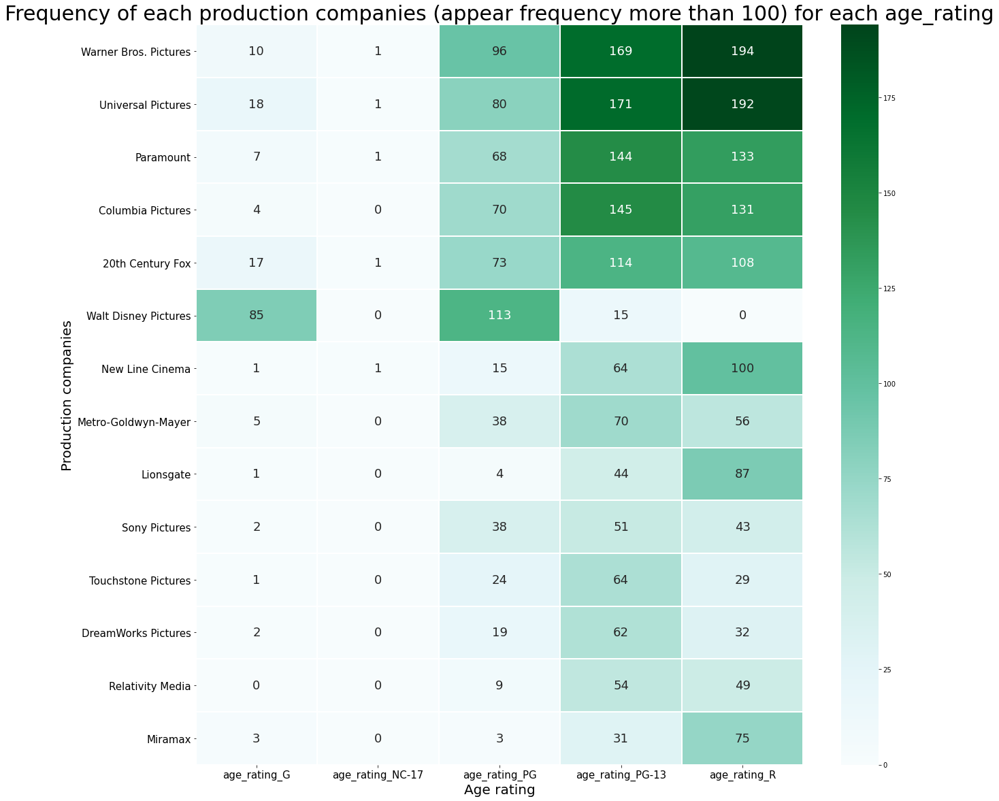

In [59]:
f = plt.figure(figsize=(20, 20))
ax = sb.heatmap(prodcomps_age_14.transpose(), linewidths = 1,
           annot = True, fmt = ".0f", annot_kws = {"size": 18}, cmap = "BuGn")
ax.set_title ("Frequency of each production companies (appear frequency more than 100) for each age_rating", size = 30)
ax.set_xlabel("Age rating", size = 20)
plt.xticks(fontsize=15)
ax.set_ylabel("Production companies", size = 20)
plt.yticks(fontsize=15)
plt.show()